In [1]:
import casadi as cs
import numpy as np
import matplotlib.pyplot as plt
import sys
import functools

loc = 'alien-windows'
if loc == 'alien-windows':
    src_root = "C:\\Users\\l8souza\\PycharmProjects\\GPMPC_HM\\src\\"
else:
    raise AssertionError
    
if src_root not in sys.path:
    sys.path.append(src_root)
print(sys.path)
%load_ext autoreload
%autoreload 2

from ds_utils import utils as ds_utils
from models import utils as models
from models import gp_wrappers as gp_wrappers
from smpc import utils as smpc
from smpc import controller_utils as controller
from sys_dyn import problem_setups
from sys_dyn import nlsys_utils as nlsys_utils
from smpc import rt_hgpmpc as rt_hgpmpc
from smpc import full_example_setup as full_example_setup
from mapping import example as hm_mapping
from mapping import nn_map
from exploration_opt import utils as exploration_utils
from exploration_opt import simd_annealing
from common import data_save_utils
from incremental_controller_impls import examples
from incremental_controller_impls import minlp_examples

['C:\\Users\\l8souza\\PycharmProjects\\GPMPC_HM\\ipynb_tests', 'C:\\Program Files\\Python38\\python38.zip', 'C:\\Program Files\\Python38\\DLLs', 'C:\\Program Files\\Python38\\lib', 'C:\\Program Files\\Python38', 'C:\\Users\\l8souza\\PycharmProjects\\GP4MPC\\venv', '', 'C:\\Users\\l8souza\\PycharmProjects\\GP4MPC\\venv\\lib\\site-packages', 'C:\\Users\\l8souza\\PycharmProjects\\GP4MPC\\venv\\lib\\site-packages\\win32', 'C:\\Users\\l8souza\\PycharmProjects\\GP4MPC\\venv\\lib\\site-packages\\win32\\lib', 'C:\\Users\\l8souza\\PycharmProjects\\GP4MPC\\venv\\lib\\site-packages\\Pythonwin', 'C:\\Users\\l8souza\\PycharmProjects\\GPMPC_HM\\src\\']


`polytope` failed to import `cvxopt.glpk`.
will use `scipy.optimize.linprog`


# Nominal MPC Offline Planning

Lower bound: [[ 0.     ]
 [-4.5    ]
 [-0.05   ]
 [-4.5    ]
 [-1.48353]
 [-5.     ]], Upper bound: [[4.     ]
 [4.5    ]
 [4.     ]
 [4.5    ]
 [1.48353]
 [5.     ]]
Lower bound: [[0.04224]
 [0.04224]], Upper bound: [[0.22251]
 [0.22251]]
Nominal MPC traj to warmstart and track solved.
[[0.18269 0.22251 0.22251 0.22251 0.22251 0.22251 0.22251 0.22251 0.22251
  0.22251 0.22251 0.22251 0.22251 0.22251 0.22251 0.22086 0.16728 0.04224
  0.04224 0.04224 0.04224 0.20526 0.21501 0.21837 0.14408 0.04225 0.04224
  0.04224 0.04224 0.04228 0.044   0.0637  0.08003 0.09015 0.09667 0.10768
  0.11524 0.07849 0.04284 0.04273 0.04271 0.04271 0.04258 0.04256 0.0425
  0.04247 0.04237 0.04236 0.04404 0.22251 0.22251 0.22251 0.22251 0.22251
  0.22251 0.22251 0.22251 0.22251 0.22251 0.22239 0.22241 0.18703 0.14261
  0.14449 0.13431 0.13981 0.1372  0.13677 0.13607 0.13669 0.13416 0.13459
  0.13513 0.13564 0.13637 0.13524 0.13593 0.13619 0.13529 0.13368 0.13681
  0.13311 0.13241 0.12964 0.13737 0.21176 0.221

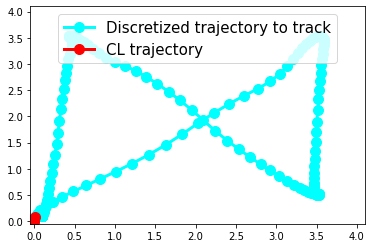

In [18]:
Q_override = np.eye(6) * 1
Q_override[0, 0] = 20
Q_override[2, 2] = 20
R_override = np.eye(2) * 0.01
examples.sanity_check_controller(x_init=np.zeros((6, 1)), N=100, closed_loop=True, num_discrete=200, simulation_length=200, velocity_override=4.5,
                                 early_termination=True, verbose=False, sampling_time=50 * 1e-3,
                                 x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, x_min_threshold=0,
                                 waypoint_arr=((3.5, 3.5), (3.5, 0.5), (0.5, 3.5), (0.1, 0.1)), simulation_length_override=5,
                                 online_N=30, Q_override=Q_override, R_override=R_override, save_desired_to_file="quad2d_dt50msN100disc200xz4_interiortrack_rdctrl_authority") 

[[0.18269 0.22251 0.22251 0.22251 0.22251 0.22251 0.22251 0.22251 0.22251
  0.22251 0.22251 0.22251 0.22251 0.22251 0.22251 0.22086 0.16728 0.04224
  0.04224 0.04224 0.04224 0.20526 0.21501 0.21837 0.14408 0.04225 0.04224
  0.04224 0.04224 0.04228 0.044   0.0637  0.08003 0.09015 0.09667 0.10768
  0.11524 0.07849 0.04284 0.04273 0.04271 0.04271 0.04258 0.04256 0.0425
  0.04247 0.04237 0.04236 0.04404 0.22251 0.22251 0.22251 0.22251 0.22251
  0.22251 0.22251 0.22251 0.22251 0.22251 0.22239 0.22241 0.18703 0.14261
  0.14449 0.13431 0.13981 0.1372  0.13677 0.13607 0.13669 0.13416 0.13459
  0.13513 0.13564 0.13637 0.13524 0.13593 0.13619 0.13529 0.13368 0.13681
  0.13311 0.13241 0.12964 0.13737 0.21176 0.22144 0.22119 0.2208  0.22054
  0.22052 0.21996 0.22003 0.22012 0.22012 0.22073 0.22209 0.22251 0.13271
  0.04275 0.04319 0.04344 0.04352 0.04343 0.04347 0.04713 0.14738 0.20288
  0.13736 0.09977 0.0831  0.07784 0.08024 0.08373 0.09112 0.09844 0.10626
  0.11476 0.12022 0.12658 0.13052 0.134

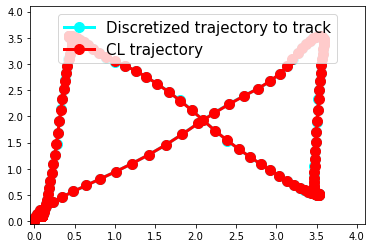

In [19]:
Q_override = np.eye(6) * 1
Q_override[0, 0] = 20
Q_override[2, 2] = 20
R_override = np.eye(2) * 0.01
examples.sanity_check_controller(x_init=np.zeros((6, 1)), N=100, closed_loop=True, num_discrete=200, simulation_length=200, velocity_override=4.5,
                                 early_termination=True, verbose=False, sampling_time=50 * 1e-3,
                                 x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, x_min_threshold=0,
                                 waypoint_arr=((3.5, 3.5), (3.5, 0.5), (0.5, 3.5), (0.1, 0.1)), simulation_length_override=None,
                                 online_N=30, Q_override=Q_override, R_override=R_override, read_desired_from_file="quad2d_dt50msN100disc200xz4_interiortrack_rdctrl_authority")

# Interior Track

## Nominal Controller

1 2
Solving for timestep: 0
t: 0, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.08504 0.08526] Solving for timestep: 1
t: 1, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.20164 0.2106 ] Solving for timestep: 2
t: 2, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.26917 0.2598 ] Solving for timestep: 3
t: 3, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.06032 0.05633] Solving for timestep: 4
t: 4, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.05632 0.06172] Solving for timestep: 5
t: 5, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.23335 0.23111] Solving for timestep: 6
t: 6, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.08873 0.09139] Solving for timestep: 7
t: 7, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.20812 0.20691] Solving for timestep: 8
t: 8, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.11003 0.11024] Solving for timestep: 9
t: 9, Ret. stat.: Solved_To_Acceptable_Level,

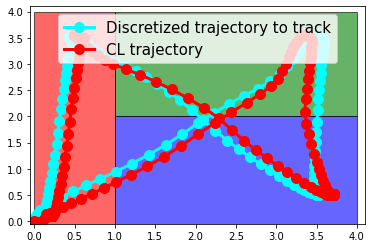

In [22]:
Q_override = np.eye(6)
Q_override[0, 0] = 20
Q_override[2, 2] = 20
R_override = np.eye(2) * 0.01

Bd_override=None
gp_input_mask_override=np.array([[0, 0, 0, 0, 0, 1, 0, 0]])
examples.gpmpc_BnC_controller(gp_fns=pw_gp_wrapped, x_init=np.zeros((6, 1)), N=100, closed_loop=True,
                             num_discrete=200, simulation_length=200, velocity_override=5, add_delta_constraints=False, fwd_sim="w_pw_res", true_ds_inst=ds_inst_in,
                             ignore_init_constr_check=True, include_res_in_ctrl=False, collision_check=True,
                             early_termination=True, verbose=False, sampling_time=100 * 1e-3,
                             x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, x_min_threshold=0,
                             waypoint_arr=((3.5, 3.5), (3.5, 0.5), (0.5, 3.5), (0.1, 0.1)), simulation_length_override=None,
                             integration_method='euler', online_N=30, read_desired_from_file="quad2d_dt50msN100disc200xz4_interiortrack_rdctrl_authority",
                             Q_override=Q_override, R_override=R_override, gp_input_mask_override=gp_input_mask_override)

## NLP-Endo Controller

#### Timing

NOT SKIPPING SHRINKING.
Shrinking by desired. MAKE SURE YOU HAVE PASSED IN THE MOST UP TO DATE X_DESIRED. This approach is to be used AFTER hlds have been generated since the hlds are used to forward
229
Solving for timestep: 0
t: 0, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.1629  0.21228] Solving for timestep: 1
t: 1, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.29668 0.29497] Solving for timestep: 2
t: 2, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.29653 0.2704 ] Solving for timestep: 3
t: 3, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.16914 0.14624] Solving for timestep: 4
t: 4, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.05836 0.05638] Solving for timestep: 5
t: 5, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.21194 0.20975] Solving for timestep: 6
t: 6, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.23815 0.23698] Solving for timestep: 7
t: 7, Ret. stat.: Solved_To_Acceptable_Level, Syste

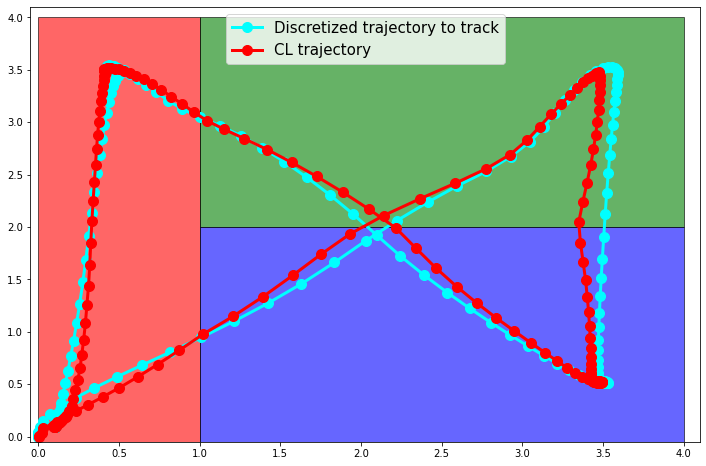

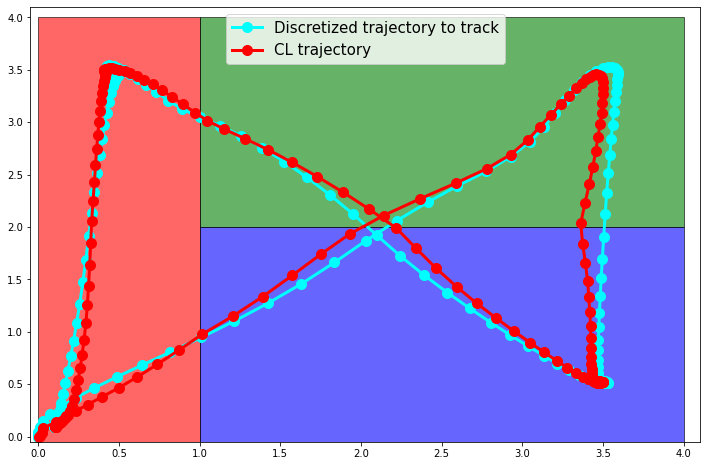

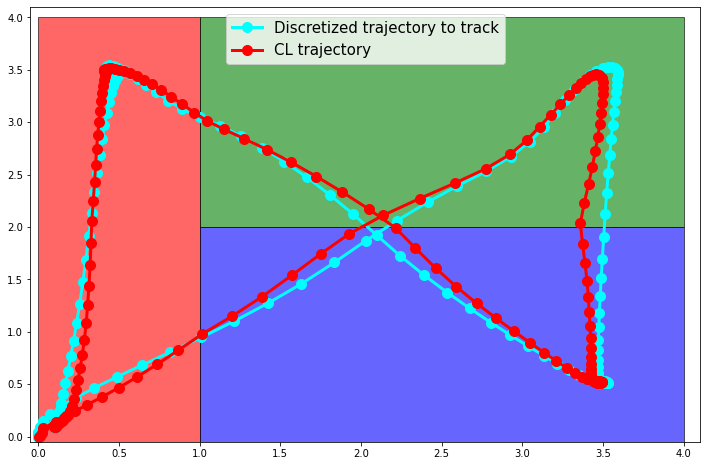

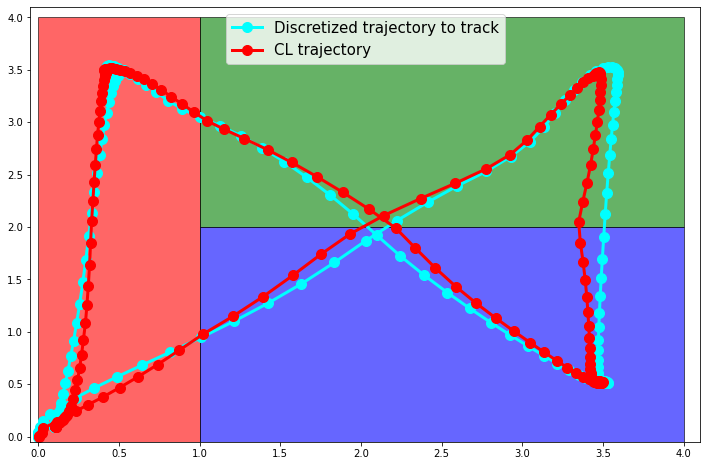

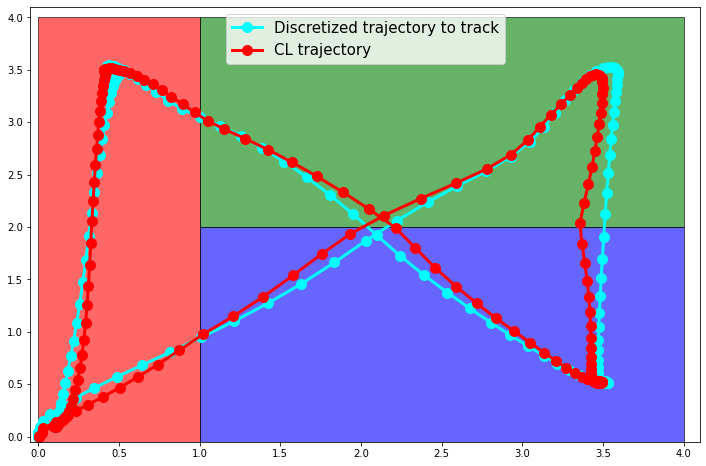

...

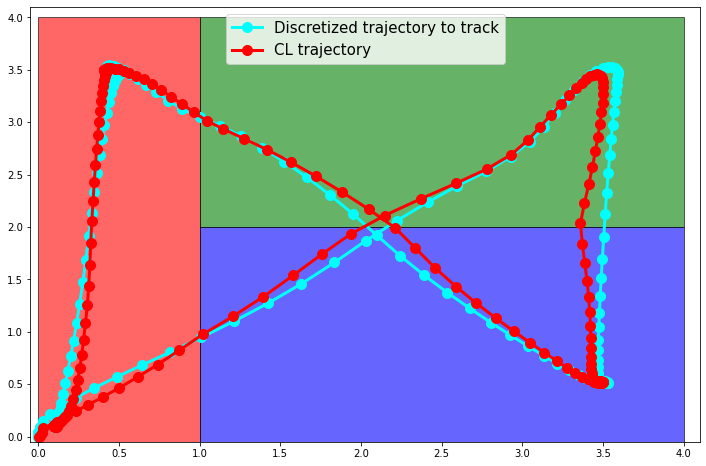

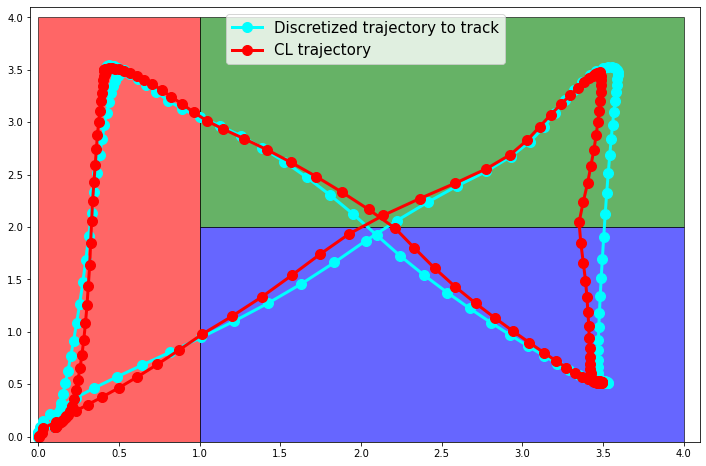

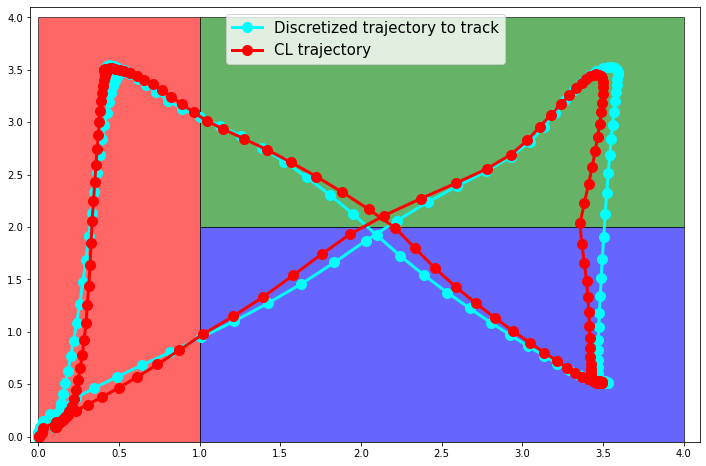

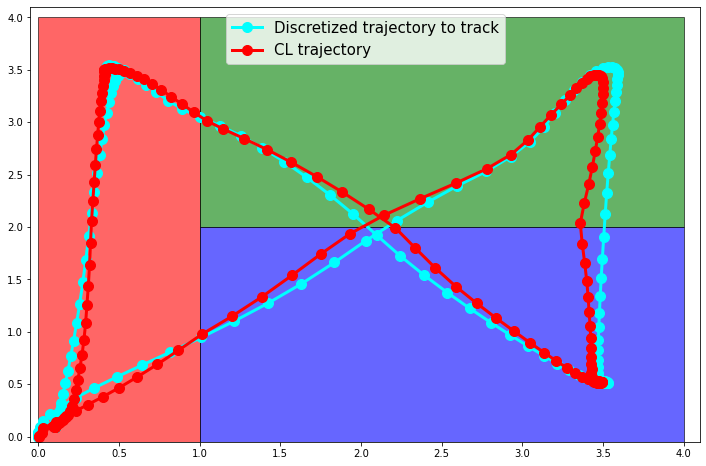

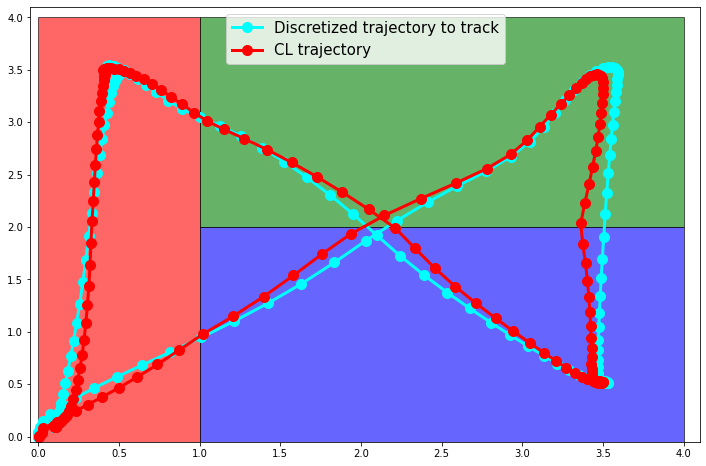

In [40]:
Q_override = np.eye(6)
Q_override[0, 0] = 20
Q_override[2, 2] = 20
R_override = np.eye(2) * 0.01

examples.gpmpc_D_controller_multiple(satisfaction_prob=0.99, gp_fns=pw_gp_wrapped, x_init=np.zeros((6, 1)), N=100, closed_loop=True,
                             num_discrete=200, simulation_length=200, velocity_override=5, add_delta_constraints=False, fwd_sim="w_pw_res", true_ds_inst=ds_inst_in,
                             ignore_init_constr_check=True, include_res_in_ctrl=True, collision_check=True,
                             early_termination=True, verbose=False, sampling_time=50 * 1e-3,
                             x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, x_min_threshold=0,
                             waypoint_arr=((3.5, 3.5), (3.5, 0.5), (0.5, 3.5), (0.1, 0.1)), simulation_length_override=None,
                             integration_method='euler', online_N=30, read_desired_from_file="quad2d_dt50msN100disc200xz4_interiortrack_rdctrl_authority",
                             Q_override=Q_override, R_override=R_override, num_multiple=100, data_save_file="final_quad2d_D_runs_dt50msN100disc200xz4_interiortrack_no_w_pen")

NOT SKIPPING SHRINKING.
Shrinking by desired. MAKE SURE YOU HAVE PASSED IN THE MOST UP TO DATE X_DESIRED. This approach is to be used AFTER hlds have been generated since the hlds are used to forward
229
Solving for timestep: 0
t: 0, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.1629  0.21228] Solving for timestep: 1
t: 1, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.29668 0.29489] Solving for timestep: 2
t: 2, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.29655 0.27055] Solving for timestep: 3
t: 3, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.1694 0.1465] Solving for timestep: 4
t: 4, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.0584  0.05638] Solving for timestep: 5
t: 5, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.21225 0.2101 ] Solving for timestep: 6
t: 6, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.23771 0.2365 ] Solving for timestep: 7
t: 7, Ret. stat.: Solved_To_Acceptable_Level, System 

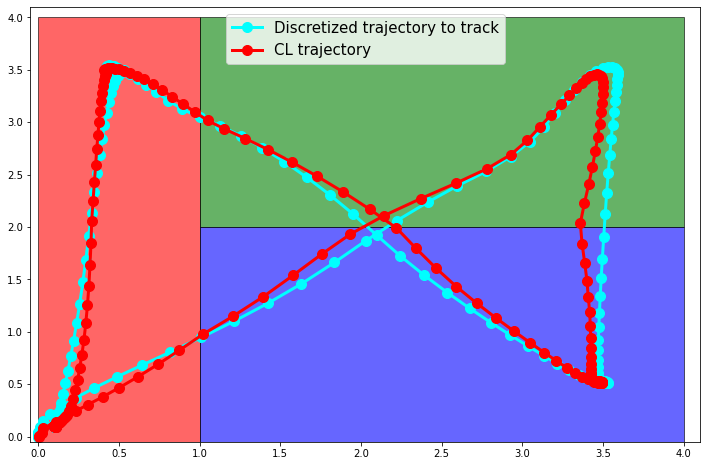

In [9]:
Q_override = np.eye(6)
Q_override[0, 0] = 20
Q_override[2, 2] = 20
R_override = np.eye(2) * 0.01

examples.gpmpc_D_controller(satisfaction_prob=0.99, gp_fns=pw_gp_wrapped, x_init=np.zeros((6, 1)), N=100, closed_loop=True,
                             num_discrete=200, simulation_length=200, velocity_override=5, add_delta_constraints=False, fwd_sim="w_pw_res", true_ds_inst=ds_inst_in,
                             ignore_init_constr_check=True, include_res_in_ctrl=True, collision_check=True,
                             early_termination=True, verbose=False, sampling_time=50 * 1e-3,
                             x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, x_min_threshold=0,
                             waypoint_arr=((3.5, 3.5), (3.5, 0.5), (0.5, 3.5), (0.1, 0.1)), simulation_length_override=None,
                             integration_method='euler', online_N=30, read_desired_from_file="quad2d_dt50msN100disc200xz4_interiortrack_rdctrl_authority",
                             Q_override=Q_override, R_override=R_override)

In [41]:
import pickle as pkl
with open("C:\\Users\\l8souza\\PycharmProjects\\GPMPC_HM\\src\\data_dir\\"+"final_quad2d_D_runs_dt50msN100disc200xz4_interiortrack_no_w_pen"+".pkl", 'rb') as f:
    data = pkl.load(f)
print(len(data))
print(np.mean([run_data["cl_cost"] for run_data in data]))
print(np.std([run_data["cl_cost"] for run_data in data]))
print(np.mean([run_data["average_run_time"] for run_data in data]))

100
67.09297852772914
0.542903427447808
0.09906931494999999


## NLP-Exo Controller

NOT SKIPPING SHRINKING.
Shrinking by desired. MAKE SURE YOU HAVE PASSED IN THE MOST UP TO DATE X_DESIRED. This approach is to be used AFTER hlds have been generated since the hlds are used to forward
229
Solving for timestep: 0
Error in Opti::solve [OptiNode] at .../casadi/core/optistack.cpp:167:
.../casadi/core/optistack_internal.cpp:999: Assertion "return_success(accept_limit)" failed:
Solver failed. You may use opti.debug.value to investigate the latest values of variables. return_status is 'Infeasible_Problem_Detected'
t: 0, Ret. stat.: Infeasible_Problem_Detected Solving for timestep: 1
Error in Opti::solve [OptiNode] at .../casadi/core/optistack.cpp:167:
.../casadi/core/optistack_internal.cpp:999: Assertion "return_success(accept_limit)" failed:
Solver failed. You may use opti.debug.value to investigate the latest values of variables. return_status is 'Infeasible_Problem_Detected'
t: 1, Ret. stat.: Infeasible_Problem_Detected Solving for timestep: 2
Error in Opti::solve [OptiNode

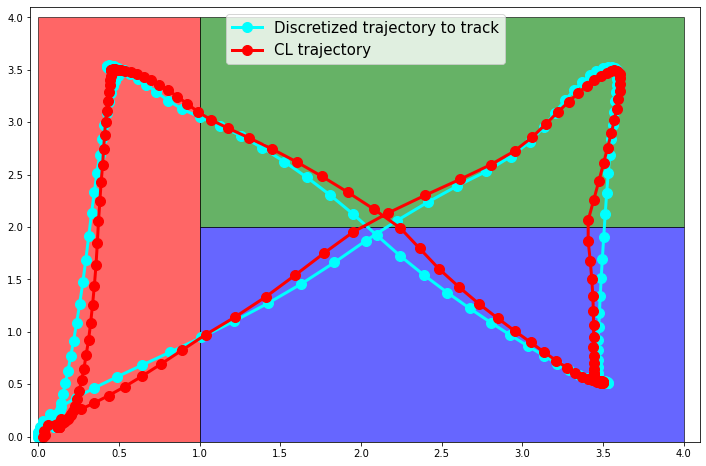

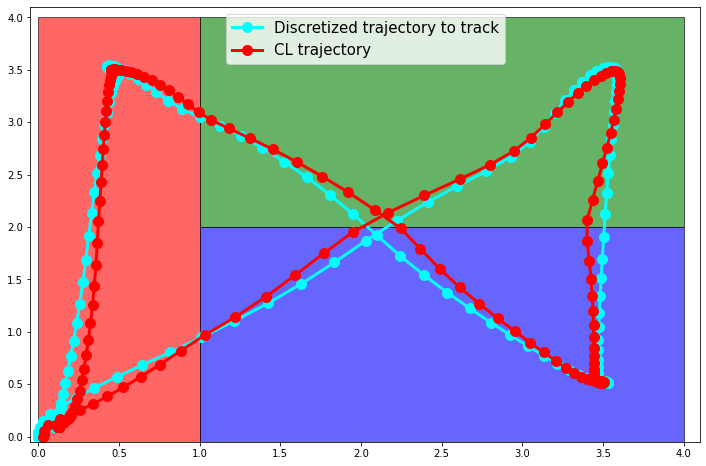

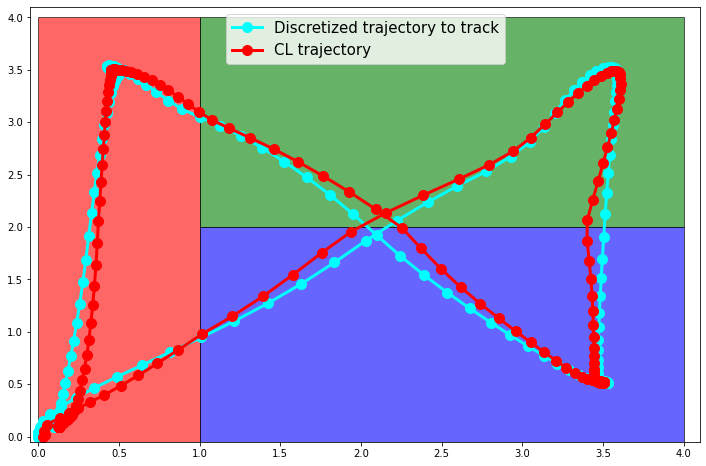

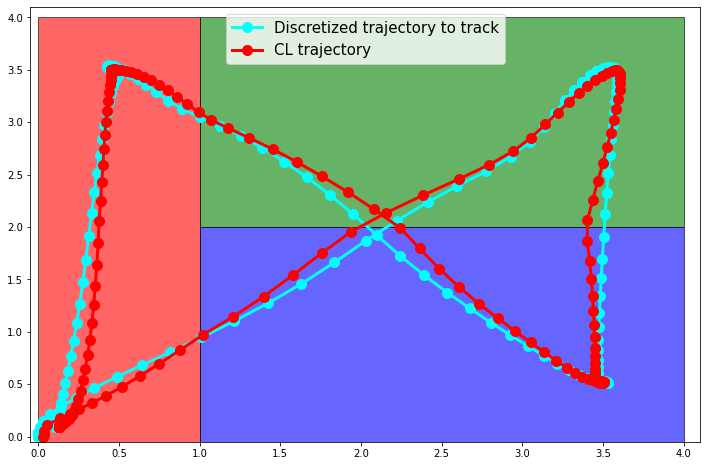

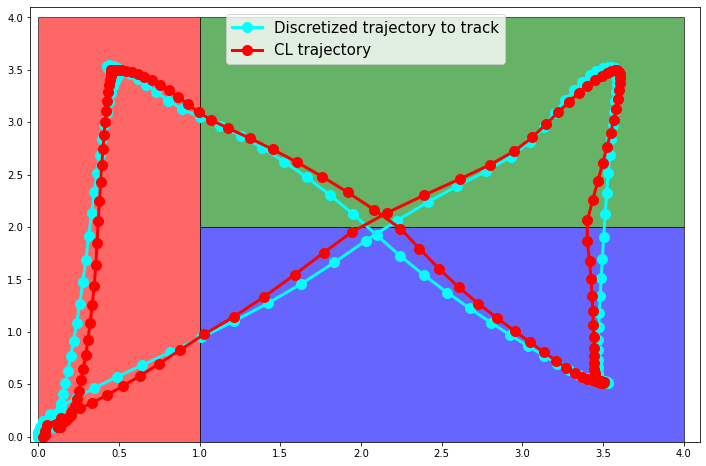

...

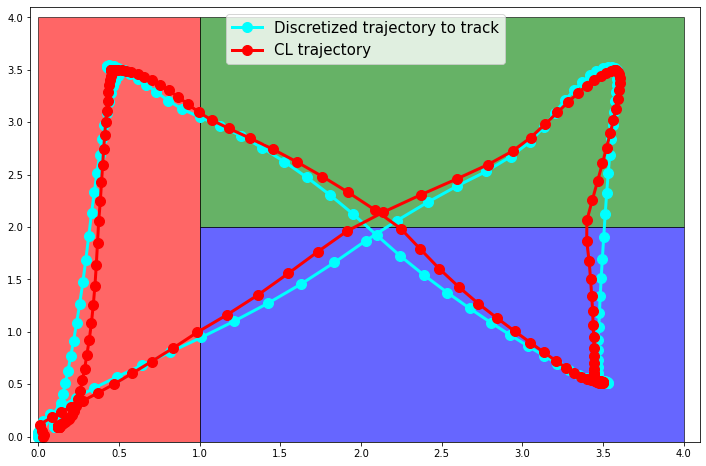

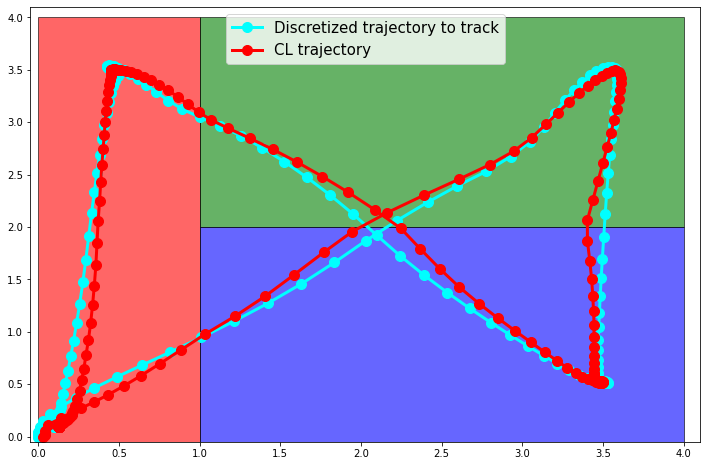

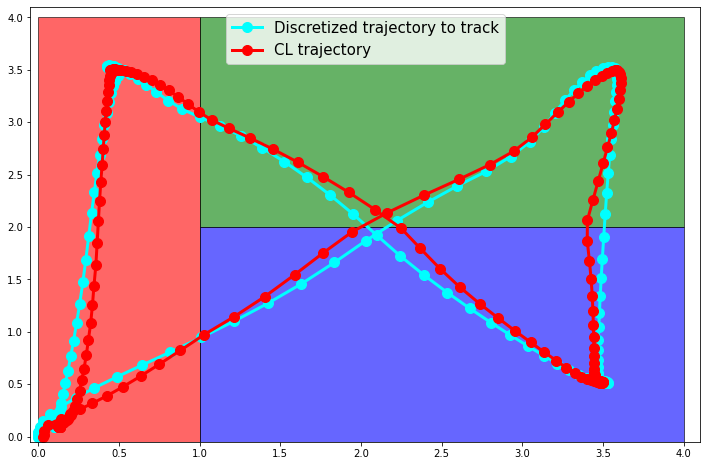

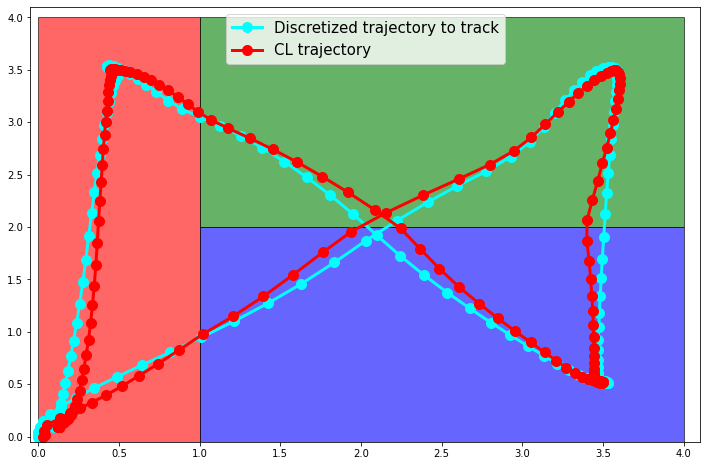

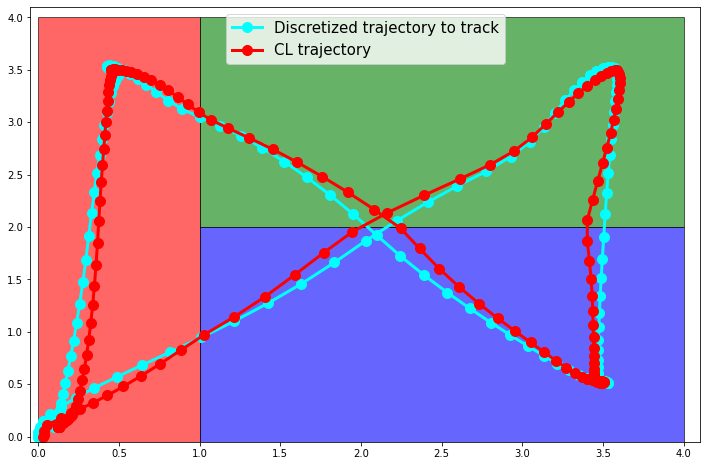

In [42]:
Q_override = np.eye(6)
Q_override[0, 0] = 20
Q_override[2, 2] = 20
R_override = np.eye(2) * 0.01

examples.gpmpc_QP_controller_multiple(satisfaction_prob=0.99, gp_fns=pw_gp_wrapped, x_init=np.zeros((6, 1)), N=100, closed_loop=True,
                             num_discrete=200, simulation_length=200, velocity_override=5, add_delta_constraints=False, fwd_sim="w_pw_res", true_ds_inst=ds_inst_in,
                             ignore_init_constr_check=True, include_res_in_ctrl=True, collision_check=True,
                             early_termination=True, verbose=False, sampling_time=50 * 1e-3,
                             x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, x_min_threshold=0,
                             waypoint_arr=((3.5, 3.5), (3.5, 0.5), (0.5, 3.5), (0.1, 0.1)), simulation_length_override=None,
                             integration_method='euler', online_N=30, read_desired_from_file="quad2d_dt50msN100disc200xz4_interiortrack_rdctrl_authority",
                             Q_override=Q_override, R_override=R_override, num_multiple=100, data_save_file="final_quad2d_QP_runs_dt50msN100disc200xz4_interiortrack_no_w_pen")

In [43]:
import pickle as pkl
with open("C:\\Users\\l8souza\\PycharmProjects\\GPMPC_HM\\src\\data_dir\\"+"final_quad2d_QP_runs_dt50msN100disc200xz4_interiortrack_no_w_pen"+".pkl", 'rb') as f:
    data = pkl.load(f)
print(len(data))
print(np.mean([run_data["cl_cost"] for run_data in data]))
print(np.std([run_data["cl_cost"] for run_data in data]))
print(np.mean([run_data["average_run_time"] for run_data in data]))

100
70.41327297131335
1.4093627230190655
0.02868529505598546


## MINLP (N=6)

NOT SKIPPING SHRINKING.
[[ 0.       0.       0.      ...  0.1003   0.1003   0.1003 ]
 [ 0.       0.       0.      ... -0.00139 -0.00139 -0.00139]
 [ 0.      -0.       0.01302 ...  0.09655  0.09655  0.09655]
 [ 0.       0.26038  0.5945  ...  0.00174  0.00174  0.00174]
 [ 0.      -0.       0.19961 ...  0.00032  0.00032  0.00032]
 [ 0.       3.99223  3.99223 ...  0.00015  0.00015  0.00015]]
[[0.18269 0.22251 0.22251 0.22251 0.22251 0.22251 0.22251 0.22251 0.22251
  0.22251 0.22251 0.22251 0.22251 0.22251 0.22251 0.22086 0.16728 0.04224
  0.04224 0.04224 0.04224 0.20526 0.21501 0.21837 0.14408 0.04225 0.04224
  0.04224 0.04224 0.04228 0.044   0.0637  0.08003 0.09015 0.09667 0.10768
  0.11524 0.07849 0.04284 0.04273 0.04271 0.04271 0.04258 0.04256 0.0425
  0.04247 0.04237 0.04236 0.04404 0.22251 0.22251 0.22251 0.22251 0.22251
  0.22251 0.22251 0.22251 0.22251 0.22251 0.22239 0.22241 0.18703 0.14261
  0.14449 0.13431 0.13981 0.1372  0.13677 0.13607 0.13669 0.13416 0.13459
  0.13513 0.13564 

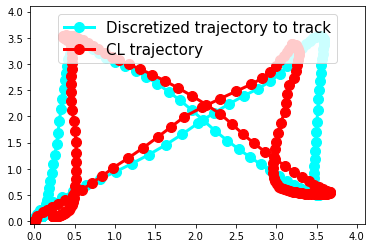

In [34]:
Q_override = np.eye(6)
Q_override[0, 0] = 20
Q_override[2, 2] = 20
R_override = np.eye(2) * 0.01

minlp_examples.gpmpc_MINLP_controller_C(satisfaction_prob=0.99, gp_fns=pw_gp_wrapped, x_init=np.zeros((6, 1)), N=100, closed_loop=True,
                             num_discrete=200, simulation_length=200, velocity_override=5, add_delta_constraints=False, true_ds_inst=ds_inst_in,
                             ignore_init_constr_check=True, collision_check=True,
                             early_termination=True, verbose=False, sampling_time=50 * 1e-3,
                             x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, x_min_threshold=0,
                             waypoint_arr=((3.5, 3.5), (3.5, 0.5), (0.5, 3.5), (0.1, 0.1)), simulation_length_override=None,
                             integration_method='euler', online_N=6, read_desired_from_file="quad2d_dt50msN100disc200xz4_interiortrack_rdctrl_authority",
                             Q_override=Q_override, R_override=R_override)

## MINLP (N=16)

NOT SKIPPING SHRINKING.
[[ 0.       0.       0.      ...  0.1003   0.1003   0.1003 ]
 [ 0.       0.       0.      ... -0.00139 -0.00139 -0.00139]
 [ 0.      -0.       0.01302 ...  0.09655  0.09655  0.09655]
 [ 0.       0.26038  0.5945  ...  0.00174  0.00174  0.00174]
 [ 0.      -0.       0.19961 ...  0.00032  0.00032  0.00032]
 [ 0.       3.99223  3.99223 ...  0.00015  0.00015  0.00015]]
[[0.18269 0.22251 0.22251 0.22251 0.22251 0.22251 0.22251 0.22251 0.22251
  0.22251 0.22251 0.22251 0.22251 0.22251 0.22251 0.22086 0.16728 0.04224
  0.04224 0.04224 0.04224 0.20526 0.21501 0.21837 0.14408 0.04225 0.04224
  0.04224 0.04224 0.04228 0.044   0.0637  0.08003 0.09015 0.09667 0.10768
  0.11524 0.07849 0.04284 0.04273 0.04271 0.04271 0.04258 0.04256 0.0425
  0.04247 0.04237 0.04236 0.04404 0.22251 0.22251 0.22251 0.22251 0.22251
  0.22251 0.22251 0.22251 0.22251 0.22251 0.22239 0.22241 0.18703 0.14261
  0.14449 0.13431 0.13981 0.1372  0.13677 0.13607 0.13669 0.13416 0.13459
  0.13513 0.13564 

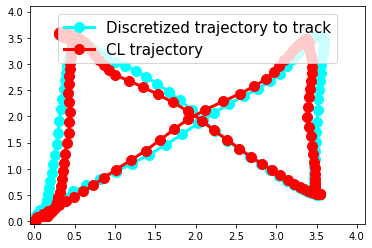

In [37]:
Q_override = np.eye(6)
Q_override[0, 0] = 20
Q_override[2, 2] = 20
R_override = np.eye(2) * 0.01

minlp_examples.gpmpc_MINLP_controller_C(satisfaction_prob=0.99, gp_fns=pw_gp_wrapped, x_init=np.zeros((6, 1)), N=100, closed_loop=True,
                             num_discrete=200, simulation_length=200, velocity_override=5, add_delta_constraints=False, true_ds_inst=ds_inst_in,
                             ignore_init_constr_check=True, collision_check=True,
                             early_termination=True, verbose=False, sampling_time=50 * 1e-3,
                             x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, x_min_threshold=0,
                             waypoint_arr=((3.5, 3.5), (3.5, 0.5), (0.5, 3.5), (0.1, 0.1)), simulation_length_override=None,
                             integration_method='euler', online_N=16, read_desired_from_file="quad2d_dt50msN100disc200xz4_interiortrack_rdctrl_authority",
                             Q_override=Q_override, R_override=R_override)

# GP Training

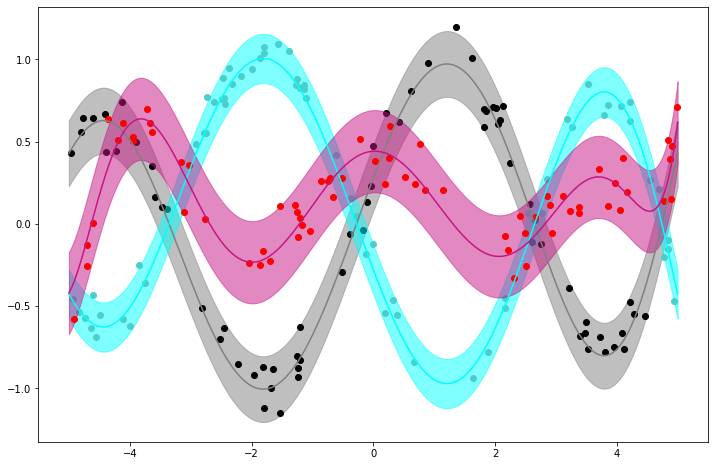

In [3]:
velocity_override = 5
setup_inst = problem_setups.quad_2d_sys_1d_inp_res(velocity_override)
regions = setup_inst["regions"]
s_start_limit, s_end_limit = setup_inst["x_start_limit"], setup_inst["x_end_limit"]
gp_input_mask = setup_inst["gp_input_mask"]
delta_input_mask = setup_inst["delta_input_mask"]
n_u = setup_inst["n_u"]
num_samples = 200
viz = True
noise_std_devs = [0.05, 0.07, 0.02]
scale_poly = 2
noise_std_devs = [0.1, 0.075, 0.125]
# noise_std_devs = [0.1, 0.075, 0.125]
# scale_poly = 2

# 0 idx is np.polynomial.polynomial.polyfromroots([-0.2, -0.05, 0, 0.2]), 1 idx is np.polynomial.polynomial.polyfromroots([-0.25, -0.05, 0.15, 0.23])
poly_coeffs = [np.array([0.0075, -0.0425, -0.2   ,  1.][::-1])*5, 
               np.array([0.04, -0.22, -0.1 ,  1.    ][::-1])*5, np.array([4.3125e-04,  5.6000e-03, -6.7000e-02, -8.0000e-02,  1.0000e+00][::-1])*5]
poly_coeffs = [np.array([-5.86024026e-05, -9.09922063e-05,  4.17839279e-03,  5.46798390e-03, -8.74124645e-02, -7.68274967e-02,  4.89430419e-01,  1.38718238e-01]),
               -np.array([-5.86024026e-05, -9.09922063e-05,  4.17839279e-03,  5.46798390e-03, -8.74124645e-02, -7.68274967e-02,  4.89430419e-01,  1.38718238e-01]),
               np.array([3.48167424e-05,  2.29572396e-05, -1.92304178e-03, -5.29264039e-04,  3.35480619e-02,  5.82899495e-04, -1.87669116e-01,  9.30450457e-03,  2.20458632e-01])]
# poly_coeffs = [[1, 0, 0], [7, 0, 0]]

ds_inst_in = ds_utils.test_1d_op_1d_inp_poly(regions=regions, poly_coeffs=poly_coeffs,
                                             start_limit=setup_inst["gpinp_subset_lim_lb"], end_limit=setup_inst["gpinp_subset_lim_ub"], gp_input_mask=gp_input_mask,
                                             delta_input_mask=delta_input_mask, n_u=n_u, num_points=num_samples,
                                             noise_vars=[noise_std_dev ** 2 for noise_std_dev in noise_std_devs],
                                             no_viz=not viz, fineness_param=(200,), scale_poly=scale_poly)

C:\Users\l8souza\PycharmProjects\GPMPC_HM\src\models\utils.py:261: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at  C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\torch\csrc\utils\tensor_new.cpp:210.)
  region_idx_labels = train_y[dim_idx, regionwise_sample_idxs[region_idx]]


Training piecewise GP
Training model: 1 for region: 1


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 350/350 [00:02<00:00, 148.51it/s]


final loss: -0.4148109257221222, lengthscale: 1.66167 noise variance (sigma**2): 0.01307, noise std dev (sigma): 0.11430
Training model: 1 for region: 2


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 350/350 [00:02<00:00, 154.75it/s]


final loss: -0.7333982586860657, lengthscale: 1.62305 noise variance (sigma**2): 0.00630, noise std dev (sigma): 0.07937
Training model: 1 for region: 3


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 350/350 [00:02<00:00, 138.13it/s]


final loss: -0.2909553050994873, lengthscale: 0.67338 noise variance (sigma**2): 0.01818, noise std dev (sigma): 0.13484


C:\Users\l8souza\PycharmProjects\GPMPC_HM\src\models\utils.py:219: UserWarning: The use of `x.T` on tensors of dimension other than 2 to reverse their shape is deprecated and it will throw an error in a future release. Consider `x.mT` to transpose batches of matricesor `x.permute(*torch.arange(x.ndim - 1, -1, -1))` to reverse the dimensions of a tensor. (Triggered internally at  C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\TensorShape.cpp:2318.)
  i_dim_labels = train_y[idx, :].T
100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 350/350 [00:01<00:00, 178.83it/s]


final loss: 0.7851365804672241, lengthscale: 3.33149 noise variance (sigma**2): 0.28143, noise std dev (sigma): 0.53050
Training global GP


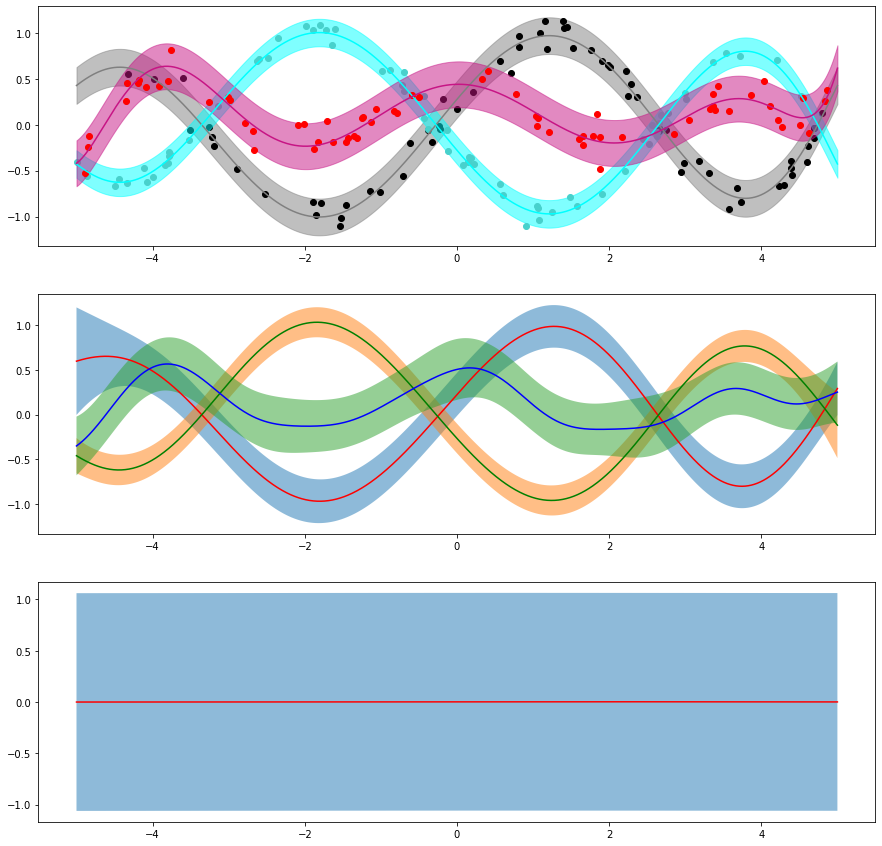

In [3]:
trained_gp_viz = True
train_verbose = True
return_error_attrs = False
seed = None
fineness_param = (75,)
num_iter = 350
true_only = False
terminate_by_change = False
save_to_file = False
load_from_file = False
file_save_name = "res_1d_poly_gp"
file_load_name = "res_1d_poly_gp"

pw_gp_wrapped, global_gp_wrapped, gp_ds_inst = gp_wrappers.train_global_n_pw(ds_inst_in, regions, viz=trained_gp_viz, verbose=train_verbose, return_error_attrs=return_error_attrs,
                                                                             seed=seed, fineness_param=fineness_param, num_iter=num_iter, true_only=true_only,
                                                                             terminate_by_change=terminate_by_change, save_to_file=save_to_file, load_from_file=load_from_file,
                                                                             file_save_name=file_save_name, file_load_name=file_load_name)